In [1]:
import pandas as pd
from geopy.extra.rate_limiter import RateLimiter
from geopy.geocoders import Nominatim
import requests
import plotly.express as px
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from collections import Counter
np.set_printoptions(suppress=True)
from itertools import combinations
pd.set_option('display.max_columns',None)
pd.set_option('display.max_colwidth', None)
from scipy.spatial.distance import squareform, pdist
pd.options.mode.chained_assignment = None  # default='warn'

### Reading Dataset and selecting columns through which we would cluster

In [2]:
df = pd.read_csv('../8Jul2020-14Jul2020.csv')
cluster = df[['StartStation Name', 'StartStation lat', 'StartStation long']]
cluster.drop_duplicates(keep='first', inplace=True)
cluster.head()

,StartStation Name,StartStation lat,StartStation long
0,"Jubilee Plaza, Canary Wharf",51.503570,-0.020068
1,"Ford Road, Old Ford",51.532513,-0.033085
2,"Houndsditch, Aldgate",51.514449,-0.077179
4,"Ossulston Street, Somers Town",51.529300,-0.128279
6,"Endsleigh Gardens, Euston",51.526838,-0.130504


### Doing K means clustering

In [3]:
X = cluster[['StartStation lat', 'StartStation long']].values
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

In [4]:
n_clusters_ = 20
kmeans = KMeans(n_clusters = n_clusters_, init ='k-means++')
kmeans.fit(X) # Compute k-means clustering.
labels = kmeans.fit_predict(X)

# Coordinates of cluster centers.
centers = kmeans.cluster_centers_ 

In [5]:
cluster['clusters'] = labels
cluster.index = cluster['StartStation Name']
cluster_map = cluster['clusters'].to_dict()

df['Cluster'] = df['StartStation Name'].map(cluster_map)
df.head()

,Rental Id,Duration,Bike Id,End Date,EndStation Id,EndStation Name,Start Date,StartStation Id,StartStation Name,EndStation lat,EndStation long,EndStation nbBikes,EndStation nbStandardBikes,EndStation nbEBikes,EndStation nbEmptyDocks,EndStation nbDocks,StartStation lat,StartStation long,StartStation nbBikes,StartStation nbStandardBikes,StartStation nbEBikes,StartStation nbEmptyDocks,StartStation nbDocks,Cluster
0,99188805,780,13656,08/07/2020 00:13,476,"Stebondale Street, Cubitt Town",08/07/2020 00:00,532,"Jubilee Plaza, Canary Wharf",51.489096,-0.009205,26,24,2,3,29,51.503570,-0.020068,46,45,1,17,63,8
1,99188806,180,4393,08/07/2020 00:03,531,"Twig Folly Bridge, Mile End",08/07/2020 00:00,517,"Ford Road, Old Ford",51.530326,-0.042744,6,6,0,15,21,51.532513,-0.033085,2,2,0,16,18,2
2,99188809,960,8973,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13
3,99188810,960,7141,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13
4,99188807,600,15085,08/07/2020 00:11,201,"Dorset Square, Marylebone",08/07/2020 00:01,797,"Ossulston Street, Somers Town",51.522596,-0.161113,15,15,0,1,16,51.529300,-0.128279,28,27,1,2,30,7


In [6]:
temp1 = df.groupby(['StartStation Name'])[['Duration']].count()
temp2 = df.groupby(['EndStation Name'])[['Duration']].count()

In [7]:
temp1_map = temp1['Duration'].to_dict()
temp2_map = temp2['Duration'].to_dict()

df['StartStation Outgoing Bike'] = df['StartStation Name'].map(temp1_map)
df['StartStation Incoming Bike'] = df['StartStation Name'].map(temp2_map)

df['EndStation Outgoing Bike'] = df['EndStation Name'].map(temp1_map)
df['EndStation Incoming Bike'] = df['EndStation Name'].map(temp2_map)

df.head()

,Rental Id,Duration,Bike Id,End Date,EndStation Id,EndStation Name,Start Date,StartStation Id,StartStation Name,EndStation lat,EndStation long,EndStation nbBikes,EndStation nbStandardBikes,EndStation nbEBikes,EndStation nbEmptyDocks,EndStation nbDocks,StartStation lat,StartStation long,StartStation nbBikes,StartStation nbStandardBikes,StartStation nbEBikes,StartStation nbEmptyDocks,StartStation nbDocks,Cluster,StartStation Outgoing Bike,StartStation Incoming Bike,EndStation Outgoing Bike,EndStation Incoming Bike
0,99188805,780,13656,08/07/2020 00:13,476,"Stebondale Street, Cubitt Town",08/07/2020 00:00,532,"Jubilee Plaza, Canary Wharf",51.489096,-0.009205,26,24,2,3,29,51.503570,-0.020068,46,45,1,17,63,8,346,333,157,148
1,99188806,180,4393,08/07/2020 00:03,531,"Twig Folly Bridge, Mile End",08/07/2020 00:00,517,"Ford Road, Old Ford",51.530326,-0.042744,6,6,0,15,21,51.532513,-0.033085,2,2,0,16,18,2,214,192,371,354
2,99188809,960,8973,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13,185,176,464,463
3,99188810,960,7141,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13,185,176,464,463
4,99188807,600,15085,08/07/2020 00:11,201,"Dorset Square, Marylebone",08/07/2020 00:01,797,"Ossulston Street, Somers Town",51.522596,-0.161113,15,15,0,1,16,51.529300,-0.128279,28,27,1,2,30,7,199,176,384,387


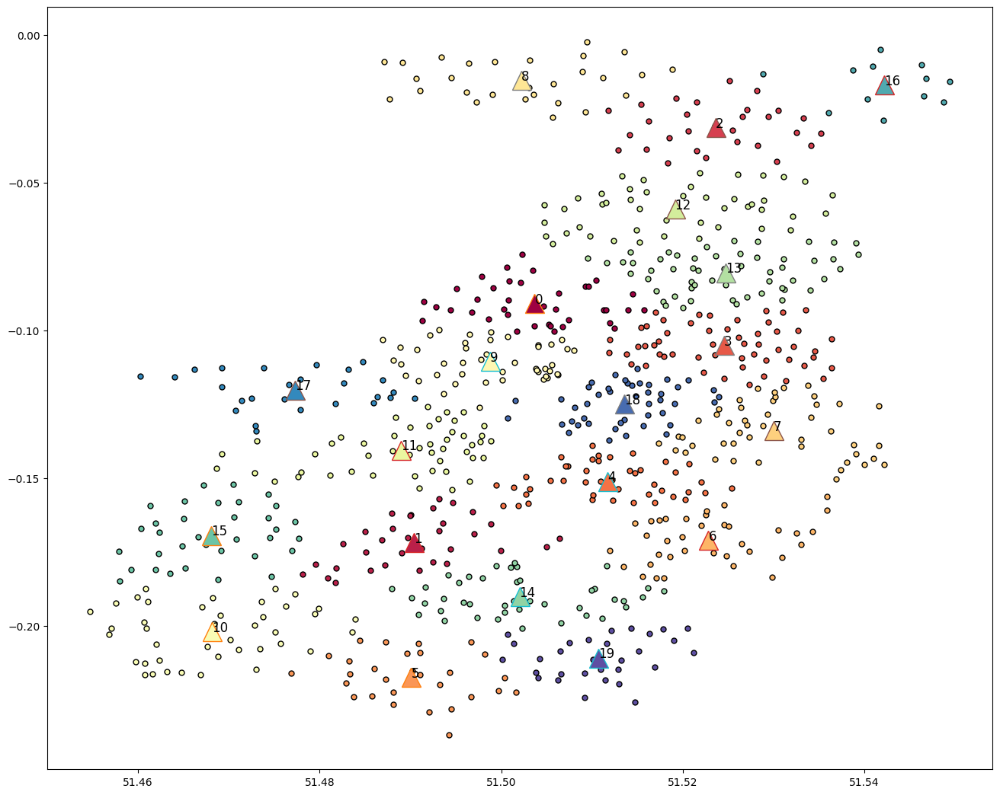

In [8]:
plt.rcParams['figure.figsize'] = [16,13]

unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]

fig, ax = plt.subplots()
for k, col in zip(unique_labels, colors):
    if k == -1:
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X[class_member_mask]
    ax.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=5)
    ax.plot(centers[k, 0], centers[k, 1], '^',markerfacecolor=tuple(col), markersize=18)
    ax.text(centers[k, 0], centers[k, 1], k,fontsize=12) 
plt.show()

In [9]:
n_clusters_ = 3
grouped = df.groupby(['Cluster'])

li = []
i = 0

for name,group in grouped:
    temp = grouped.get_group(name)
    
    X = temp[['StartStation Outgoing Bike', 'EndStation Incoming Bike']].values
    kmeans = KMeans(n_clusters = n_clusters_, init ='k-means++')
    kmeans.fit(X) # Compute k-means clustering.
    labels = kmeans.fit_predict(X)
    
    temp['Region'] = labels + i*3
    i += 1
    
    li.append(temp)

C:\Users\rahin\AppData\Local\Temp\ipykernel_7724\189635673.py:7: FutureWarning: In a future version of pandas, a length 1 tuple will be returned when iterating over a groupby with a grouper equal to a list of length 1. Don't supply a list with a single grouper to avoid this warning.
  for name,group in grouped:


In [10]:
final_df = pd.concat(li)
final_df.sort_index(inplace=True)
final_df.head()

,Rental Id,Duration,Bike Id,End Date,EndStation Id,EndStation Name,Start Date,StartStation Id,StartStation Name,EndStation lat,EndStation long,EndStation nbBikes,EndStation nbStandardBikes,EndStation nbEBikes,EndStation nbEmptyDocks,EndStation nbDocks,StartStation lat,StartStation long,StartStation nbBikes,StartStation nbStandardBikes,StartStation nbEBikes,StartStation nbEmptyDocks,StartStation nbDocks,Cluster,StartStation Outgoing Bike,StartStation Incoming Bike,EndStation Outgoing Bike,EndStation Incoming Bike,Region
0,99188805,780,13656,08/07/2020 00:13,476,"Stebondale Street, Cubitt Town",08/07/2020 00:00,532,"Jubilee Plaza, Canary Wharf",51.489096,-0.009205,26,24,2,3,29,51.503570,-0.020068,46,45,1,17,63,8,346,333,157,148,25
1,99188806,180,4393,08/07/2020 00:03,531,"Twig Folly Bridge, Mile End",08/07/2020 00:00,517,"Ford Road, Old Ford",51.530326,-0.042744,6,6,0,15,21,51.532513,-0.033085,2,2,0,16,18,2,214,192,371,354,6
2,99188809,960,8973,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13,185,176,464,463,41
3,99188810,960,7141,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13,185,176,464,463,41
4,99188807,600,15085,08/07/2020 00:11,201,"Dorset Square, Marylebone",08/07/2020 00:01,797,"Ossulston Street, Somers Town",51.522596,-0.161113,15,15,0,1,16,51.529300,-0.128279,28,27,1,2,30,7,199,176,384,387,22


In [11]:
import plotly.express as px

fig = px.scatter(final_df, x="StartStation lat", y="StartStation long", color="Region")
fig.show()

### Mapping Cluster, Lat and Long to add in the *temp* dataframe

In [12]:
temp_df = final_df[['StartStation Name', 'Cluster', 'StartStation lat', 'StartStation long']]
temp_df.set_index(['StartStation Name'], inplace=True)

var1 = temp_df['Cluster'].to_dict()
var2 = temp_df['StartStation lat'].to_dict()
var3 = temp_df['StartStation long'].to_dict()

In [13]:
temp = final_df.groupby(['Region', 'Cluster', 'StartStation Name', 'EndStation Name'])[['Duration']].count()
temp.rename(columns={'Duration':'Count'}, inplace=True)
temp.reset_index(drop=False, inplace=True)
temp = temp[temp['Count'] >= 20]
temp.head()

,Region,Cluster,StartStation Name,EndStation Name,Count
275,0,0,"Bermondsey Street, Bermondsey","Bermondsey Street, Bermondsey",31
485,0,0,"Borough High Street, The Borough","Borough High Street, The Borough",22
629,0,0,"Bricklayers Arms, Borough","Bricklayers Arms, Borough",30
1160,0,0,"Empire Square, The Borough","Empire Square, The Borough",36
1684,0,0,"Great Tower Street, Monument","Great Tower Street, Monument",22


In [14]:
temp['End Station Cluster'] = temp['EndStation Name'].map(var1)
temp['StartStation lat'] = temp['EndStation Name'].map(var2)
temp['StartStation long'] = temp['EndStation Name'].map(var3)

temp = temp[temp['Cluster'] != temp['End Station Cluster']]
temp.reset_index(drop=True, inplace = True)
temp.head()

,Region,Cluster,StartStation Name,EndStation Name,Count,End Station Cluster,StartStation lat,StartStation long
0,1,0,"Duke Street Hill, London Bridge","Tower Gardens , Tower",20,13,51.509506,-0.075459
1,1,0,"Duke Street Hill, London Bridge","Wellington Arch, Hyde Park",20,4,51.502740,-0.149569
2,1,0,"Monument Street, Monument","Westminster Pier, Westminster",20,18,51.501513,-0.123823
3,1,0,"Queen Street 2, Bank","Westminster Pier, Westminster",21,18,51.501513,-0.123823
4,1,0,"Tooley Street, Bermondsey","Somerset House, Strand",22,18,51.509943,-0.117619


In [15]:
temp3 = df['StartStation Name'].values
temp4 = df[['StartStation lat', 'StartStation long']].apply(tuple, axis=1).values

pos = {A: B for A, B in zip(temp3, temp4)}

In [16]:
X = np.array(temp[['StartStation Name', 'EndStation Name']])
y = np.array(temp['Count'])

temp1 = temp[['StartStation Name', 'EndStation Name']].apply(tuple, axis=1).values
temp2 = temp['Count'].values

edge_labels = {A: B for A, B in zip(temp1, temp2)}

Edges 99
Clique 86


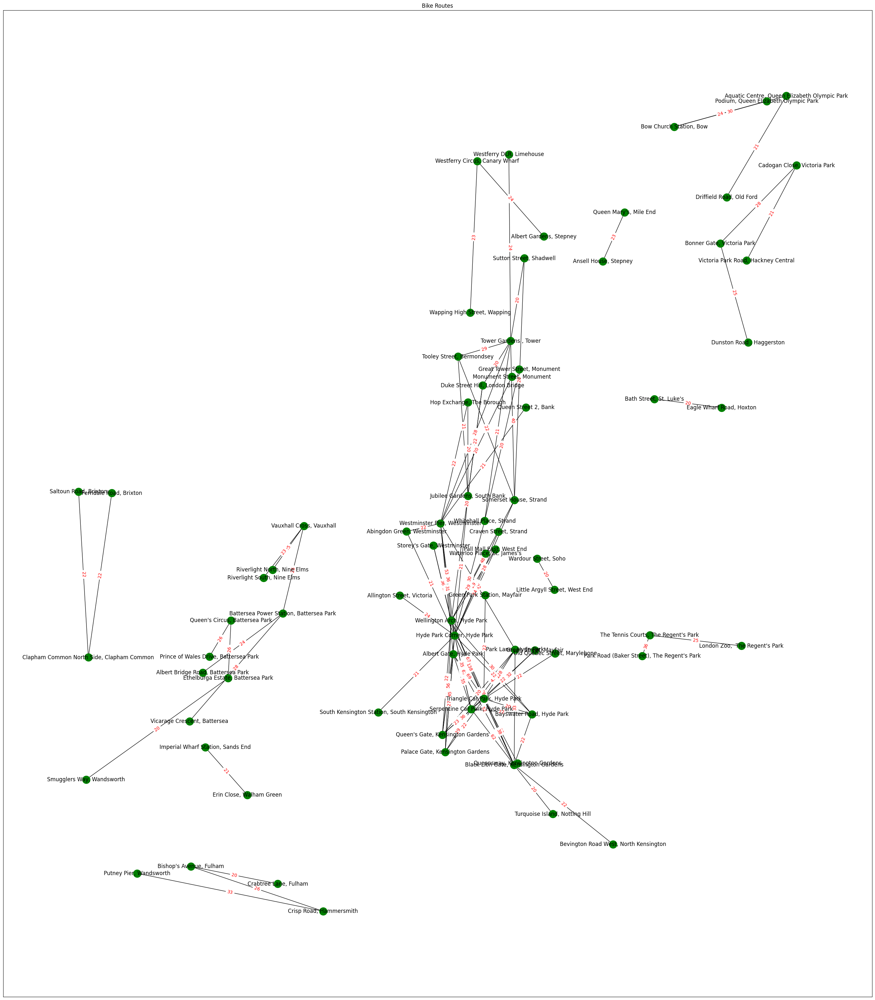

In [17]:
G = nx.Graph()
G.add_edges_from(X)
plt.figure(figsize =(35, 40))
nx.draw_networkx(G, pos = pos, node_color ='green')
nx.draw_networkx_edge_labels(G, pos = pos,
                             edge_labels=edge_labels,
                             font_color='red')

num_edges = G.number_of_edges()
print("Edges", num_edges)

# find all cliques in the graph
cliques = list(nx.find_cliques(G))

# count the number of cliques
num_cliques = len(cliques)
print("Clique", num_cliques)



plt.title("Bike Routes")
plt.show()

### Clique

In [18]:
test = []
cliques = nx.find_cliques(G)
for clique in cliques:
    test += clique

clique_dict = Counter(test)

temp2 = pd.DataFrame.from_dict(clique_dict, orient='index').reset_index()
temp2.rename(columns = {'index':'StartStation Name', 0: 'Clique'}, inplace = True)
temp2.shape

(75, 2)

In [19]:
clique_station_list = temp2['StartStation Name'].values
non_clique_df = final_df[~final_df['StartStation Name'].isin(clique_station_list)]
non_clique_df.head()

,Rental Id,Duration,Bike Id,End Date,EndStation Id,EndStation Name,Start Date,StartStation Id,StartStation Name,EndStation lat,EndStation long,EndStation nbBikes,EndStation nbStandardBikes,EndStation nbEBikes,EndStation nbEmptyDocks,EndStation nbDocks,StartStation lat,StartStation long,StartStation nbBikes,StartStation nbStandardBikes,StartStation nbEBikes,StartStation nbEmptyDocks,StartStation nbDocks,Cluster,StartStation Outgoing Bike,StartStation Incoming Bike,EndStation Outgoing Bike,EndStation Incoming Bike,Region
0,99188805,780,13656,08/07/2020 00:13,476,"Stebondale Street, Cubitt Town",08/07/2020 00:00,532,"Jubilee Plaza, Canary Wharf",51.489096,-0.009205,26,24,2,3,29,51.503570,-0.020068,46,45,1,17,63,8,346,333,157,148,25
1,99188806,180,4393,08/07/2020 00:03,531,"Twig Folly Bridge, Mile End",08/07/2020 00:00,517,"Ford Road, Old Ford",51.530326,-0.042744,6,6,0,15,21,51.532513,-0.033085,2,2,0,16,18,2,214,192,371,354,6
2,99188809,960,8973,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13,185,176,464,463,41
3,99188810,960,7141,08/07/2020 00:17,508,"Fournier Street, Whitechapel",08/07/2020 00:01,779,"Houndsditch, Aldgate",51.519362,-0.074431,8,8,0,10,18,51.514449,-0.077179,3,3,0,25,28,13,185,176,464,463,41
4,99188807,600,15085,08/07/2020 00:11,201,"Dorset Square, Marylebone",08/07/2020 00:01,797,"Ossulston Street, Somers Town",51.522596,-0.161113,15,15,0,1,16,51.529300,-0.128279,28,27,1,2,30,7,199,176,384,387,22


In [20]:
from sklearn.neighbors import NearestNeighbors
import numpy as np

def nearest_neighbor(stations):
    num_stations = len(stations)
    deficit = np.where(stations[:, 2] <= 5)[0]
    surplus = np.where(stations[:, 2] > 15)[0]
    nn = NearestNeighbors(n_neighbors=num_stations-1)
    nn.fit(stations[:,:2])

    for i, need_station in enumerate(deficit):
        distances, nn_indices = nn.kneighbors(stations[need_station,:2].reshape(1,-1))
        nn_index = nn_indices[0,0]
        if stations[deficit[nn_index], 2] < stations[surplus[i], 2]:
            diff = stations[surplus[i], 2] - stations[deficit[nn_index], 2]
            stations[deficit[nn_index], 2] += diff
            stations[surplus[i], 2] -= diff
        
    return stations

In [21]:
regions_dict = {}

number_of_nonclique_region = sorted(non_clique_df['Region'].unique())

for i in number_of_nonclique_region:
    temp_df = non_clique_df[non_clique_df['Region'] == i]
    temp = temp_df.groupby(['StartStation Name']).first()[['StartStation lat', 'StartStation long']]
    eucd_distance = pd.DataFrame(squareform(pdist(temp.iloc[:, :])), columns=temp.index.unique(), index=temp.index.unique())    

    X = np.array(np.meshgrid(eucd_distance.columns, eucd_distance.columns)).T.reshape(-1, 2)
    y = eucd_distance.values.flatten()


    temp1 = [tuple(i) for i in X]
    temp2 = eucd_distance.values.flatten()

    edge_labels = {A: B for A, B in zip(temp1, temp2)}
    
    temp3 = final_df['StartStation Name'].values
    temp4 = final_df[['StartStation lat', 'StartStation long']].apply(tuple, axis=1).values

    pos = {A: B for A, B in zip(temp3, temp4)}
    
    G = nx.Graph()
    G.add_edges_from(X)

    G = nx.Graph()
    G.add_edges_from(X)

    mst = nx.minimum_spanning_tree(G)

    regions_dict['Region{}'.format(str(i+1))] =  mst.size(weight="weight")

In [22]:
mst_regions_df = pd.DataFrame(list(regions_dict.items()), columns=['Region', 'MST'])
mst_regions_df.describe()

,MST
count,55.000000
mean,28.327273
std,14.013293
min,0.000000
25%,24.500000
50%,28.000000
75%,38.000000
max,52.000000


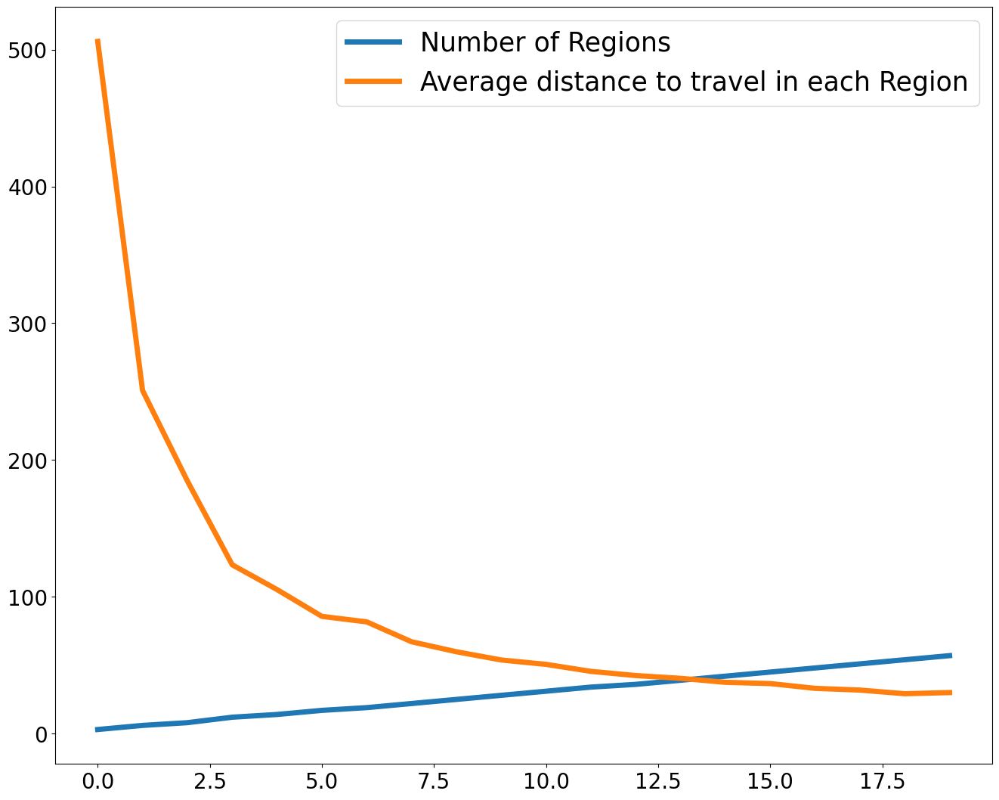

In [23]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv('evaluation_dataset.csv')
lines = df.plot.line(linewidth=5)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.legend(fontsize=25)

plt.show()


In [24]:
df = pd.read_csv('connection_strength.csv')
df.head()

,Bike flow,Number of edges,Number of cliques
0,1,29582,334949
1,5,3326,2727
2,10,710,589
3,15,192,153
4,20,98,77


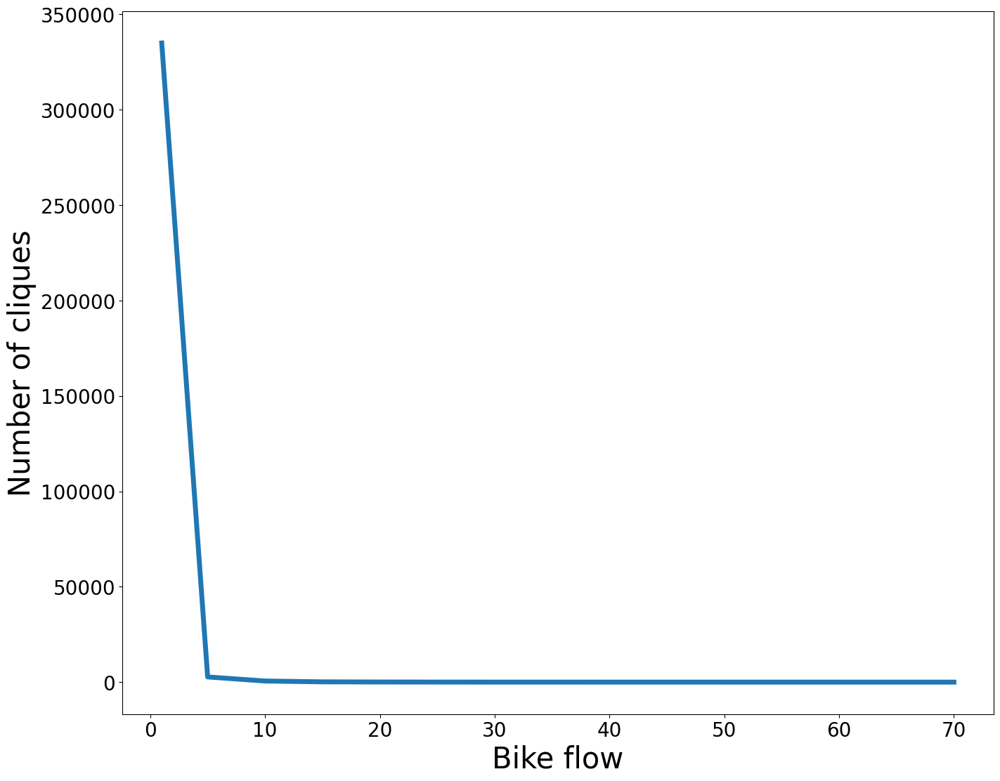

In [25]:
import matplotlib.pyplot as plt

lines = df.plot.line(x='Bike flow', y='Number of cliques', linewidth=5)
plt.xlabel('Bike flow', fontsize=30)
plt.ylabel('Number of cliques', fontsize=30)

# Set fontsize of tick labels
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Hide the legend
plt.legend().remove()

plt.show()


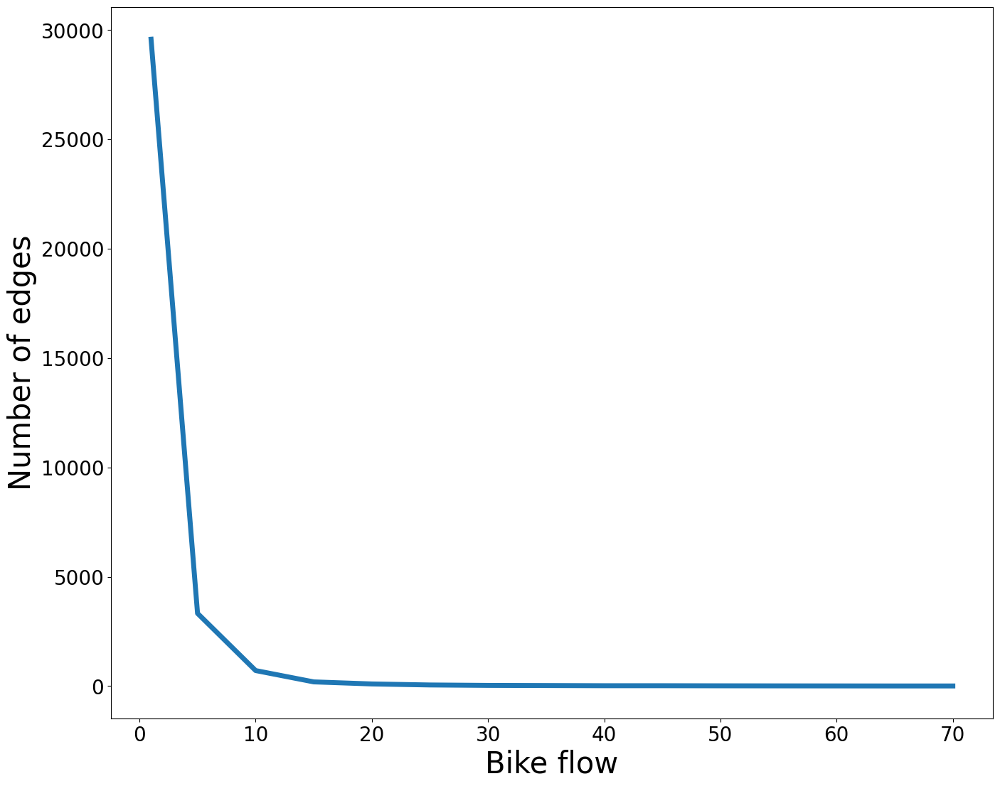

In [26]:
import matplotlib.pyplot as plt

lines = df.plot.line(x='Bike flow', y='Number of edges', linewidth=5)

plt.xlabel('Bike flow', fontsize=30)
plt.ylabel('Number of edges', fontsize=30)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Remove the legend
plt.legend().remove()

plt.show()